In [5]:
# !git clone https://github.com/Trustworthy-ML-Lab/CLIP-dissect
# !pip install ftfy regex
import os
# os.chdir('CLIP-dissect')

import torch
import pandas as pd

import clip
import utils
import data_utils
import similarity
import matplotlib
from experiments import text_colorings
from matplotlib import pyplot as plt
import collections

100%|██████████| 256/256 [00:00<00:00, 3605.64it/s]


torch.Size([256, 1000])


100%|██████████| 512/512 [00:00<00:00, 2497.57it/s]


torch.Size([512, 1000])


100%|██████████| 1024/1024 [00:00<00:00, 2335.63it/s]


torch.Size([1024, 1000])


100%|██████████| 2048/2048 [00:00<00:00, 2805.96it/s]


torch.Size([2048, 1000])


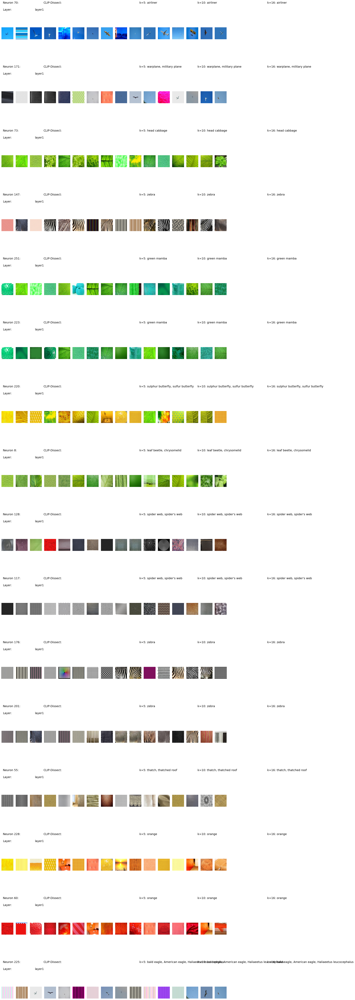

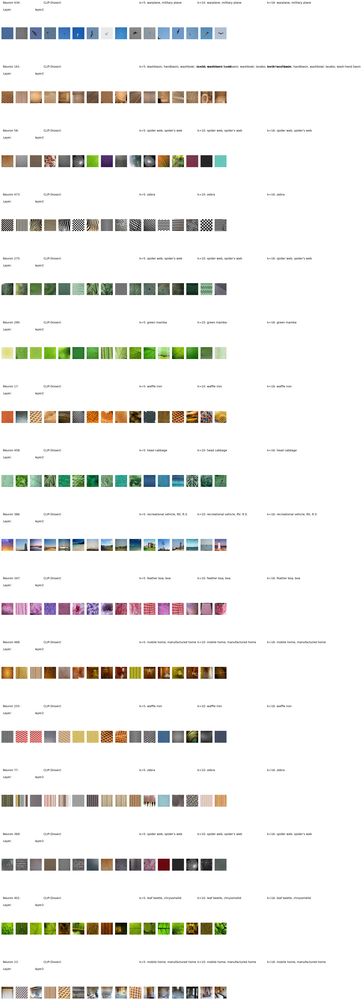

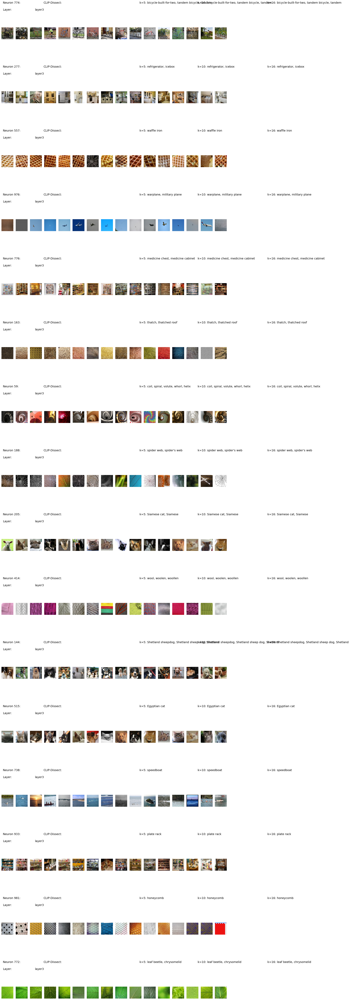

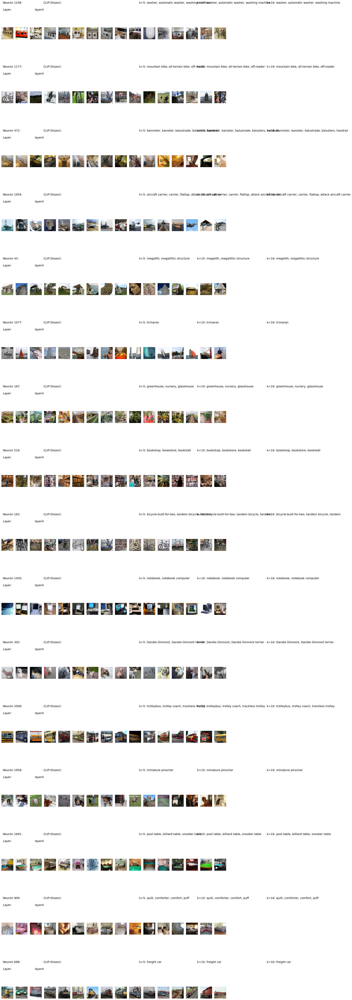

In [14]:
# For K= 5,10,16
settings = {'layer1': {"target_name":'resnet50', "target_layer": 'layer1', "neurons_to_display": "CLIP-Dissect"},
            'layer2': {"target_name":'resnet50', "target_layer": 'layer2', "neurons_to_display": "CLIP-Dissect"},
            'layer3': {"target_name":'resnet50', "target_layer": 'layer3', "neurons_to_display": "CLIP-Dissect"},
            'layer4': {"target_name":'resnet50', "target_layer": 'layer4', "neurons_to_display": "CLIP-Dissect"}
           }


layers = ['layer1','layer2','layer3','layer4']

for i in layers:
  layer = i

  target_name = settings[layer]["target_name"]
  target_layer = settings[layer]["target_layer"]
  neurons_to_display = settings[layer]["neurons_to_display"]
  clip_name = 'ViT-B/16'
  d_probe = 'broden'
  concept_set = 'data/imagenet_labels.txt'
  batch_size = 50
  device = 'cuda'
  pool_mode = 'avg'
  save_dir = 'saved_activations'
  similarity_fn = similarity.soft_wpmi
  utils.save_activations(clip_name = clip_name, target_name = target_name, target_layers = [target_layer],
                       d_probe = d_probe, concept_set = concept_set, batch_size = batch_size,
                       device = device, pool_mode=pool_mode, save_dir = save_dir)
  layer_broden = utils.get_save_names(clip_name = clip_name, target_name = target_name,
                                  target_layer = target_layer, d_probe = d_probe,
                                  concept_set = concept_set, pool_mode=pool_mode,
                                  save_dir = save_dir)

  target_layer_broden, clip_layer_broden, text_layer_broden = layer_broden

  similarities, target_feats = utils.get_similarity_from_activations(target_layer_broden, clip_layer_broden,
                                                              text_layer_broden, similarity_fn, device=device)

  with open(concept_set, 'r') as f:
      words = (f.read()).split('\n')

  pil_data = data_utils.get_data(d_probe)
  top_vals, top_ids = torch.topk(target_feats, k=16, dim=0)

  get_color = text_colorings.get_coloring(layer)

  name_conversion = {'resnet50':'resnet50_imagenet', 'resnet18_places':'resnet18_places365'}
  ood_names = {'resnet50':'p', 'resnet18_places': 'i'}

  if type(neurons_to_display)==list:
      ids_to_check = neurons_to_display
  if neurons_to_display == "CLIP-Dissect":
      ids_to_check = torch.sort(torch.max(similarities, dim=1)[0], descending=True)[1][0:16]

  font_size = 14
  font = {'size': font_size}
  matplotlib.rc('font', **font)

  fig = plt.figure(figsize=[ 20, len(ids_to_check)*4.4])  
  subfigs = fig.subfigures(nrows=len(ids_to_check), ncols=1)

  for j, orig_id in enumerate(ids_to_check):
      _, ids_5 = torch.topk(similarities[orig_id], k=5, largest=True)
      _, ids_10 = torch.topk(similarities[orig_id], k=10, largest=True)
      _, ids_16 = torch.topk(similarities[orig_id], k=16, largest=True)

      subfig = subfigs[j]
      # Displaying Neuron ID and Layer Info
      subfig.text(0.13, 0.96, "Neuron {}:".format(int(orig_id)), size=font_size)
      subfig.text(0.27, 0.96, "CLIP-Dissect:", size=font_size)
      subfig.text(0.13, 0.85, "Layer:", size=font_size)
      subfig.text(0.24, 0.85, layer, size=font_size)

    # This is for the best guess on the figure code, which leads to all k=5,10,16 to be equal guess

      best_guess_labels = {
          5: words[int(ids_5[0])],
          10: words[int(ids_10[0])],
          16: words[int(ids_16[0])]
      }

      for pos, label in best_guess_labels.items():
          subfig.text(0.4 + 0.04*pos, 0.96, f"k={pos}: {label}", size=font_size, color=get_color("clip", j))

      axs = subfig.subplots(nrows=1, ncols=16)
      for i, top_id in enumerate(top_ids[:, orig_id]):
          im, label = pil_data[top_id]
          im = im.resize([375, 375])
          axs[i].imshow(im)
          axs[i].axis('off')
plt.show()

---
---

In [10]:
num_neurons_per_layer = [256, 512, 1024, 2048]  
data_list = [] 

for layer_index, layer in enumerate(layers):
    # Initialize layer settings
    target_name = settings[layer]["target_name"]
    target_layer = settings[layer]["target_layer"]
    neurons_to_display = settings[layer]["neurons_to_display"]
    clip_name = 'ViT-B/16'
    d_probe = 'broden'
    concept_set = 'data/imagenet_labels.txt'
    batch_size = 50
    device = 'cuda'
    pool_mode = 'avg'
    save_dir = 'saved_activations'
    similarity_fn = similarity.soft_wpmi

    # Calculate similarities
    utils.save_activations(clip_name=clip_name, target_name=target_name, target_layers=[target_layer],
                           d_probe=d_probe, concept_set=concept_set, batch_size=batch_size,
                           device=device, pool_mode=pool_mode, save_dir=save_dir)
    layer_broden = utils.get_save_names(clip_name=clip_name, target_name=target_name,
                                        target_layer=target_layer, d_probe=d_probe,
                                        concept_set=concept_set, pool_mode=pool_mode,
                                        save_dir=save_dir)
    target_layer_broden, clip_layer_broden, text_layer_broden = layer_broden
    similarities, target_feats = utils.get_similarity_from_activations(target_layer_broden, clip_layer_broden,text_layer_broden, similarity_fn, device=device)
    similarities_shape = similarities.shape
    
    if similarities_shape[0] != num_neurons_per_layer[layer_index]:
        raise ValueError(f"Unexpected number of neurons in layer {layer}. Expected: {num_neurons_per_layer[layer_index]}, Found: {similarities_shape[0]}")

    with open(concept_set, 'r') as f:
        words = [line.strip() for line in f if line.strip()]  

    if not words:
        raise ValueError("The 'words' list is empty. Check the 'concept_set' file contents and path.")

    # Get data for the probe
    pil_data = data_utils.get_data(d_probe)   
    print("Similarities tensor shape:", similarities.shape)
    num_neurons = similarities.shape[0]
    print("Number of neurons:", num_neurons)
    
    for neuron_id in range(num_neurons_per_layer[layer_index]):
        values_5, indices_5 = torch.topk(similarities[neuron_id, :], k=5, largest=True)
        values_10, indices_10 = torch.topk(similarities[neuron_id, :], k=10, largest=True)
        values_16, indices_16 = torch.topk(similarities[neuron_id, :], k=16, largest=True)

        top_label_5 = words[indices_5[0]]  # Top label for k=5
        top_label_10 = words[indices_10[0]]  # Top label for k=10
        top_label_16 = words[indices_16[0]]  # Top label for k=16

        # Check if the top label for k=5 remains the top label for k=10 and k=16
        rank_stability_5_10 = (top_label_5 == top_label_10)
        rank_stability_10_16 = (top_label_10 == top_label_16)
        rank_stability_5_16 = (top_label_5 == top_label_16)

        new_row = {
            'Layer': layer,
            'Neuron': neuron_id,
            'Top Label k=5': top_label_5,
            'Top Label k=10': top_label_10,
            'Top Label k=16': top_label_16,
            'Rank Stability k=5 to k=10': rank_stability_5_10,
            'Rank Stability k=10 to k=16': rank_stability_10_16,
            'Rank Stability k=5 to k=16': rank_stability_5_16
        }
        data_list.append(new_row)
results_df = pd.DataFrame(data_list)
# Calculate accuracy
stability_score_5_10 = results_df['Rank Stability k=5 to k=10'].sum() / len(results_df) * 100
stability_score_10_16 = results_df['Rank Stability k=10 to k=16'].sum() / len(results_df) * 100
stability_score_5_16 = results_df['Rank Stability k=5 to k=16'].sum() / len(results_df) * 100

print(f"Rank Stability Score from k=5 to k=10: {stability_score_5_10}%")
print(f"Rank Stability Score from k=10 to k=16: {stability_score_10_16}%")
print(f"Rank Stability Score from k=5 to k=16: {stability_score_5_16}%")


100%|██████████| 256/256 [00:00<00:00, 2206.89it/s]


torch.Size([256, 1000])
Similarities tensor shape: torch.Size([256, 1000])
Number of neurons: 256


100%|██████████| 512/512 [00:00<00:00, 1816.85it/s]


torch.Size([512, 1000])
Similarities tensor shape: torch.Size([512, 1000])
Number of neurons: 512


100%|██████████| 1024/1024 [00:00<00:00, 1684.68it/s]


torch.Size([1024, 1000])
Similarities tensor shape: torch.Size([1024, 1000])
Number of neurons: 1024


100%|██████████| 2048/2048 [00:00<00:00, 2134.12it/s]


torch.Size([2048, 1000])
Similarities tensor shape: torch.Size([2048, 1000])
Number of neurons: 2048
Rank Stability Score from k=5 to k=10: 100.0%
Rank Stability Score from k=10 to k=16: 100.0%
Rank Stability Score from k=5 to k=16: 100.0%


To analyze rank stability in a way that is meaningful, you should compare the entire ordered list of top-5 activations to the first 5 in the top-10, and similarly compare the first 5 in the top-10 to the first 5 in the top-16. This way, you're checking if any new labels have emerged in the higher ranked positions that were not present in the smaller set.

In [11]:
num_neurons_per_layer = [256, 512, 1024, 2048]  
data_list = [] 

for layer_index, layer in enumerate(layers):
    # Initialize layer settings
    target_name = settings[layer]["target_name"]
    target_layer = settings[layer]["target_layer"]
    neurons_to_display = settings[layer]["neurons_to_display"]
    clip_name = 'ViT-B/16'
    d_probe = 'broden'
    concept_set = 'data/imagenet_labels.txt'
    batch_size = 50
    device = 'cuda'
    pool_mode = 'avg'
    save_dir = 'saved_activations'
    similarity_fn = similarity.soft_wpmi

    # Calculate similarities
    utils.save_activations(clip_name=clip_name, target_name=target_name, target_layers=[target_layer],
                           d_probe=d_probe, concept_set=concept_set, batch_size=batch_size,
                           device=device, pool_mode=pool_mode, save_dir=save_dir)
    layer_broden = utils.get_save_names(clip_name=clip_name, target_name=target_name,
                                        target_layer=target_layer, d_probe=d_probe,
                                        concept_set=concept_set, pool_mode=pool_mode,
                                        save_dir=save_dir)
    target_layer_broden, clip_layer_broden, text_layer_broden = layer_broden
    similarities, target_feats = utils.get_similarity_from_activations(target_layer_broden, clip_layer_broden,text_layer_broden, similarity_fn, device=device)
    similarities_shape = similarities.shape
    
    if similarities_shape[0] != num_neurons_per_layer[layer_index]:
        raise ValueError(f"Unexpected number of neurons in layer {layer}. Expected: {num_neurons_per_layer[layer_index]}, Found: {similarities_shape[0]}")

    with open(concept_set, 'r') as f:
        words = [line.strip() for line in f if line.strip()]  

    if not words:
        raise ValueError("The 'words' list is empty. Check the 'concept_set' file contents and path.")

    # Get data for the probe
    pil_data = data_utils.get_data(d_probe)   
    print("Similarities tensor shape:", similarities.shape)
    num_neurons = similarities.shape[0]
    print("Number of neurons:", num_neurons)
    
    for neuron_id in range(num_neurons_per_layer[layer_index]):
    # Get the top 5, 10, and 16 activation indices
    _, indices_5 = torch.topk(similarities[neuron_id, :], k=5, largest=True)
    _, indices_10 = torch.topk(similarities[neuron_id, :], k=10, largest=True)
    _, indices_16 = torch.topk(similarities[neuron_id, :], k=16, largest=True)

    # Convert indices to labels
    labels_5 = [words[idx] for idx in indices_5]
    labels_10 = [words[idx] for idx in indices_10[:5]]  # Only consider the top 5
    labels_16 = [words[idx] for idx in indices_16[:5]]  # Only consider the top 5

    # Check if the sets of labels are the same (which implies rank stability)
    stability_5_10 = set(labels_5) == set(labels_10)
    stability_5_16 = set(labels_5) == set(labels_16)

    new_row = {
        'Layer': layer,
        'Neuron ID': neuron_id,
        'Labels k=5': labels_5,
        'Labels k=10': labels_10,
        'Labels k=16': labels_16,
        'Stability 5-10': stability_5_10,
        'Stability 5-16': stability_5_16
    }
    data_list.append(new_row)

results_df = pd.DataFrame(data_list)

# Calculate stability
stability_score_5_10 = results_df['Stability 5-10'].sum() / len(results_df) * 100
stability_score_5_16 = results_df['Stability 5-16'].sum() / len(results_df) * 100

print(f"Stability Score from k=5 to k=10: {stability_score_5_10}%")
print(f"Stability Score from k=5 to k=16: {stability_score_5_16}%")

100%|██████████| 256/256 [00:00<00:00, 2229.14it/s]


torch.Size([256, 1000])
Similarities tensor shape: torch.Size([256, 1000])
Number of neurons: 256


100%|██████████| 512/512 [00:00<00:00, 2804.34it/s]


torch.Size([512, 1000])
Similarities tensor shape: torch.Size([512, 1000])
Number of neurons: 512


100%|██████████| 1024/1024 [00:00<00:00, 2200.68it/s]


torch.Size([1024, 1000])
Similarities tensor shape: torch.Size([1024, 1000])
Number of neurons: 1024


100%|██████████| 2048/2048 [00:01<00:00, 1960.54it/s]


torch.Size([2048, 1000])
Similarities tensor shape: torch.Size([2048, 1000])
Number of neurons: 2048
Stability Score from k=5 to k=10: 99.94791666666667%
Stability Score from k=5 to k=16: 99.97395833333333%


In this updated version, you compare the set of top-5 labels from the top-5 activations to the first 5 labels from the top-10 and top-16 activations, which allows you to observe if any labels have been replaced by others as k increases, indicating a change in the neuron's preference ranking for different concepts.